Generating adversarial examples using the Fast-Gradient Sign Method [1] and Projected Gradient Descent [2].

[1] Goodfellow IJ, Shlens J, Szegedy C. Explaining and harnessing adversarial examples. arXiv preprint arXiv:1412.6572. 2014 Dec 20.
[2] Madry A. Towards deep learning models resistant to adversarial attacks. arXiv preprint arXiv:1706.06083. 2017.

Based on https://www.tensorflow.org/tutorials/generative/adversarial_fgsm

In [ ]:
import tensorflow as tf
import matplotlib as mpl
import matplotlib.pyplot as plt

In [ ]:
mpl.rcParams['figure.figsize'] = (8, 8)
mpl.rcParams['axes.grid'] = False

In [ ]:
pretrained_model = tf.keras.applications.MobileNetV2(include_top=True)
pretrained_model.trainable = False

# ImageNet Labels
decode_predictions = tf.keras.applications.mobilenet_v2.decode_predictions

14536120/14536120 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [ ]:
# Convert any image into the input format for MobileNetV2
def preprocess(image):
  if image.shape[-1] == 4:
        image = image[..., :3]
  image = tf.cast(image, tf.float32)
  image = tf.image.resize(image, (224, 224))
  image = tf.keras.applications.mobilenet_v2.preprocess_input(image)
  image = image[None, ...]
  return image

In [ ]:
# Extract label of image net prediction from probabilities
def get_imagenet_label(probs):
  return decode_predictions(probs, top=1)[0][0]

In [ ]:
image_path = tf.keras.utils.get_file('Apple.jpg', 'https://hips.hearstapps.com/hmg-prod/images/ripe-apple-royalty-free-image-1659454396.jpg?crop=0.924xw:0.679xh;0.0197xw,0.212xh&resize=980:*')
image_raw = tf.io.read_file(image_path)
image = tf.image.decode_image(image_raw)

image = preprocess(image)
image_probs = pretrained_model.predict(image)

86372/86372 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step


[[('n07742313', 'Granny_Smith', 0.36885235)]]


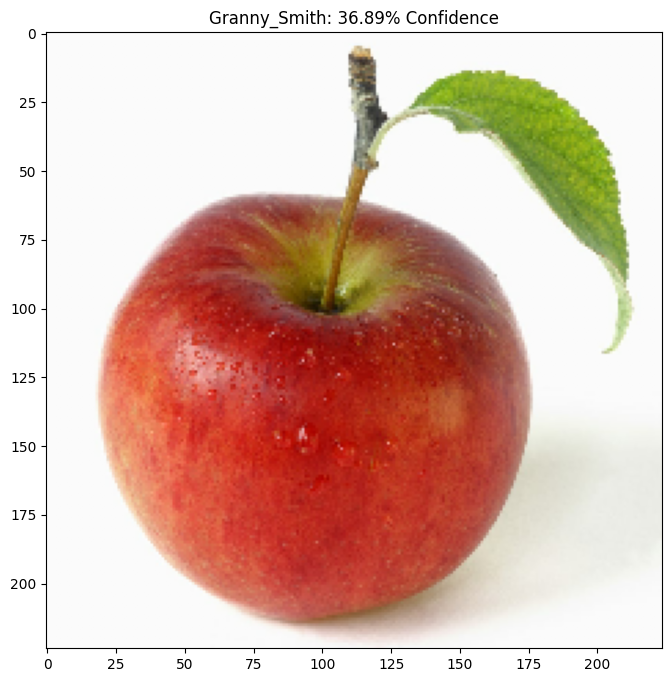

In [ ]:
plt.figure()
plt.imshow(image[0] * 0.5 + 0.5)
_, image_class, class_confidence = get_imagenet_label(image_probs)
plt.title('{}: {:.2f}% Confidence'.format(image_class, class_confidence*100))
plt.show()

# Fast-Gradient Sign Method

In [ ]:
def create_adversarial_perturbation(input_image, input_label):
  # input_image should be predicted as input_label
  loss_obj = tf.keras.losses.CategoricalCrossentropy()

  with tf.GradientTape() as tape:
    tape.watch(input_image)
    prediction = pretrained_model(input_image)
    loss = loss_obj(input_label, prediction)

    # FGSM - Gradient of loss w.r.t. input
    grad = tape.gradient(loss, input_image)
  # FGSM - Sign of gradients puts pertubation on edge of ell-infinity ball
  return tf.sign(grad)

In [ ]:
def display_image(image, desc):
  _, label, conf = get_imagenet_label(pretrained_model.predict(image))
  plt.figure()
  plt.imshow(image[0] * 0.5 + 0.5)
  plt.title(f"{desc}\n{label}: {conf * 100}")
  plt.show()

In [ ]:
def FGSM_adversary(image, label_index, epsilon):
  label = tf.one_hot(label_index, image_probs.shape[-1])
  label = tf.reshape(label, (1, image_probs.shape[-1]))

  perturbation = create_adversarial_perturbation(image, label)
  display_image(image, "Original")
  display_image(perturbation, "Perturbation")
  adversary = image + epsilon * perturbation
  adversary = tf.clip_by_value(adversary, -1, 1)
  display_image(adversary, "Adversary")
  return adversary


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


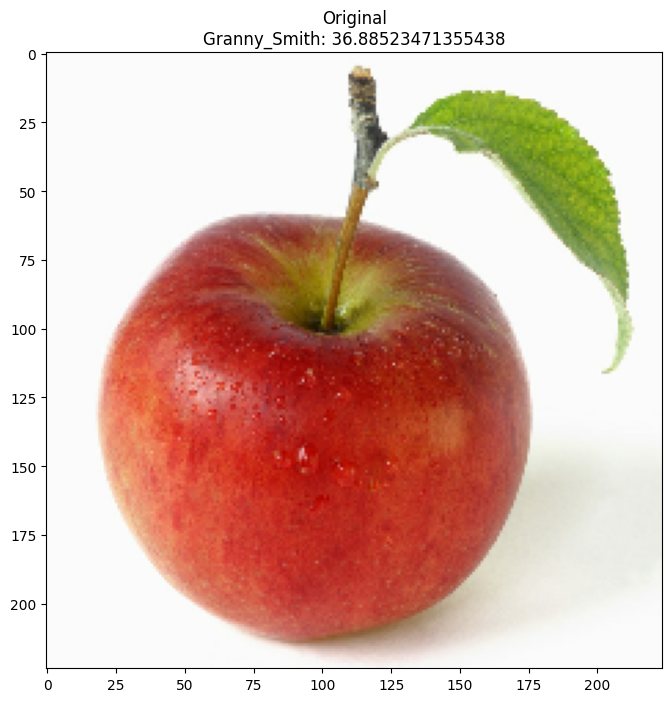

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


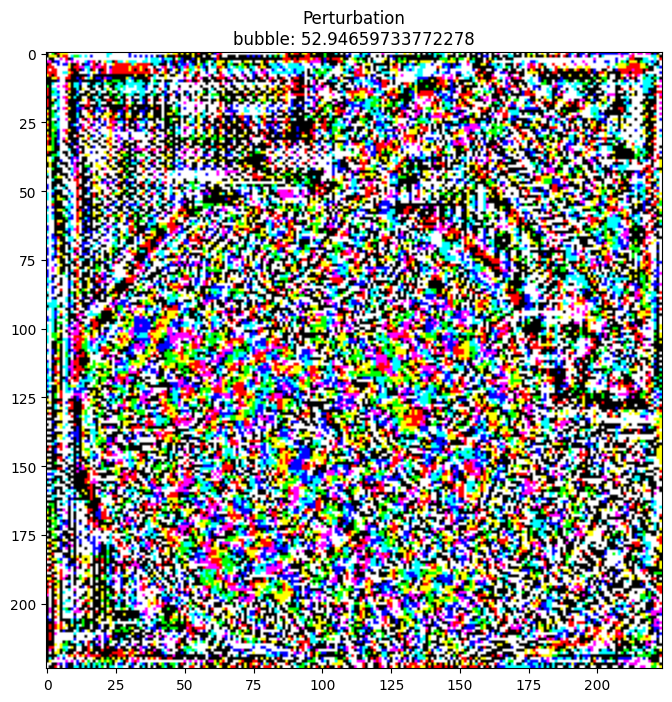

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step


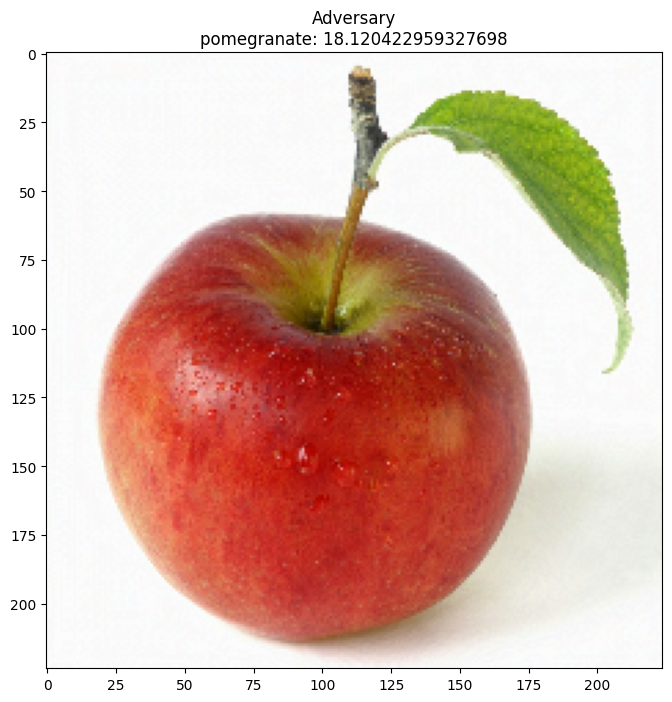

In [ ]:
granny_smith_index = 948
FGSM_adversary(image, granny_smith_index, 0.01)

# Projected Gradient Descent

In [ ]:
def PGD_adversary(image, label_index, alpha, epsilon, iterations):
  img = tf.identity(image)
  for _ in range(iterations):
    image_var = tf.Variable(img)
    iter_adversary = FGSM_adversary(image_var, label_index, alpha)
    img = tf.clip_by_value(iter_adversary, image - epsilon, image + epsilon)
  return img

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


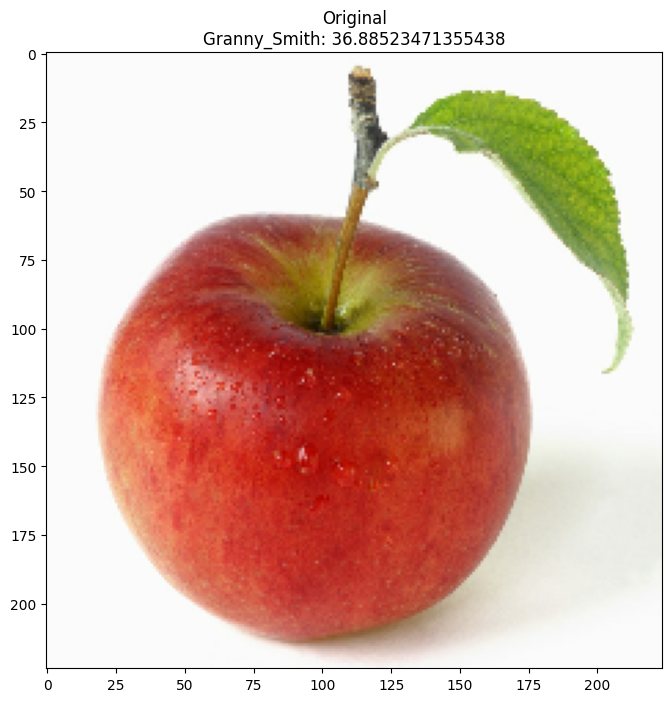

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step


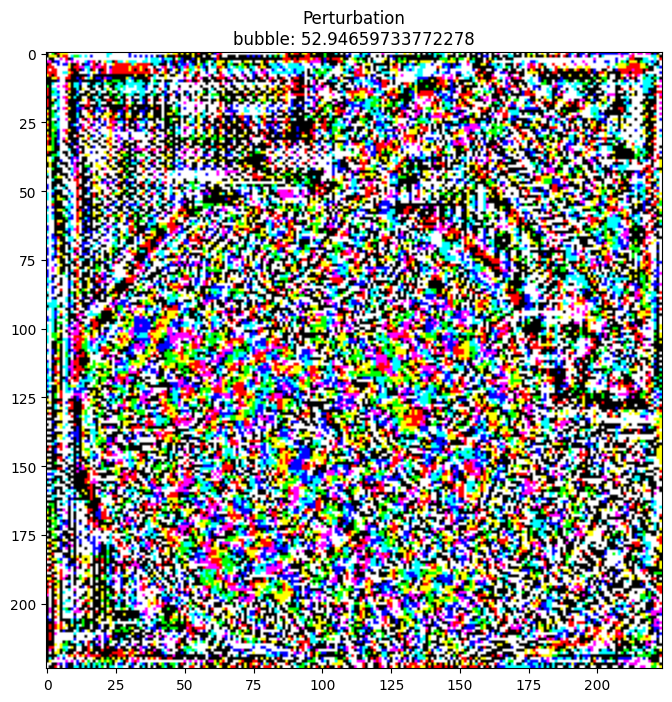

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 242ms/step


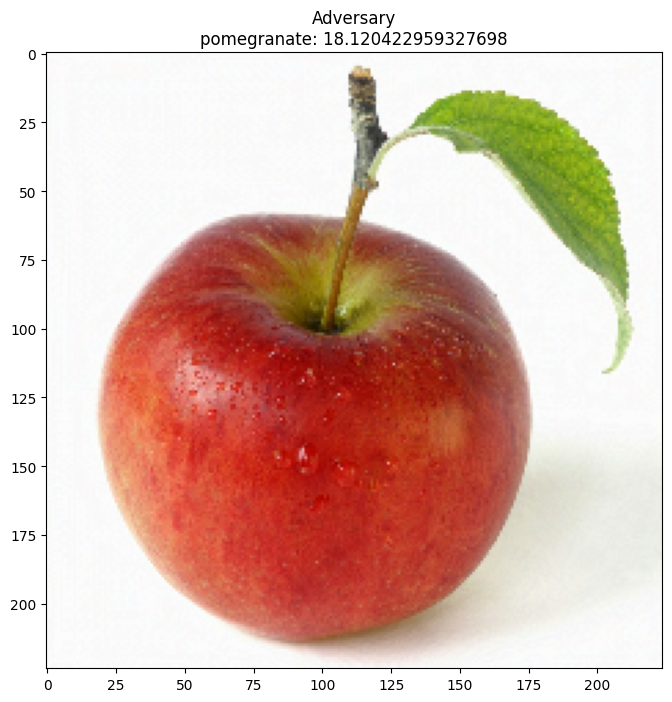

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


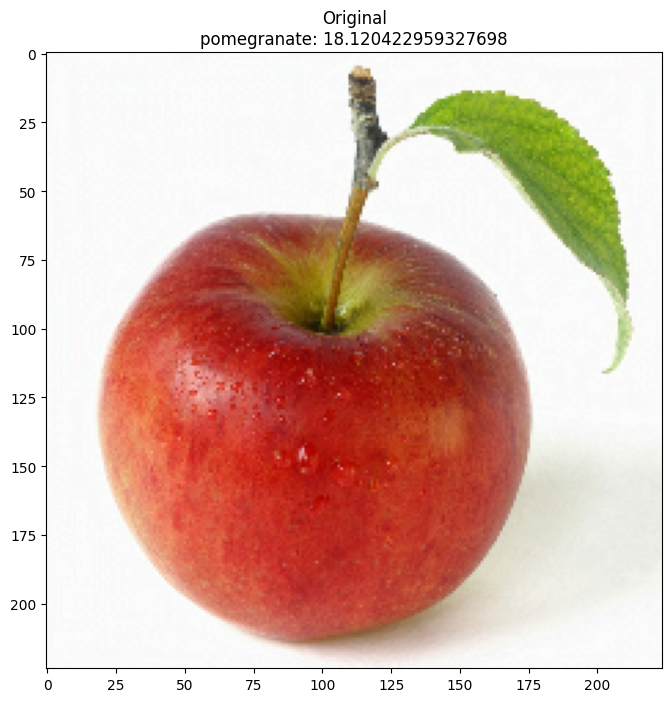

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


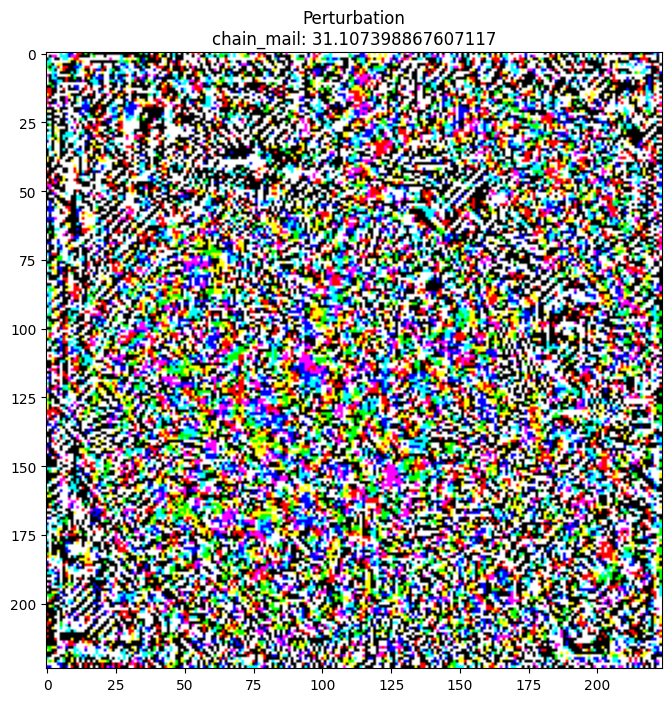

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


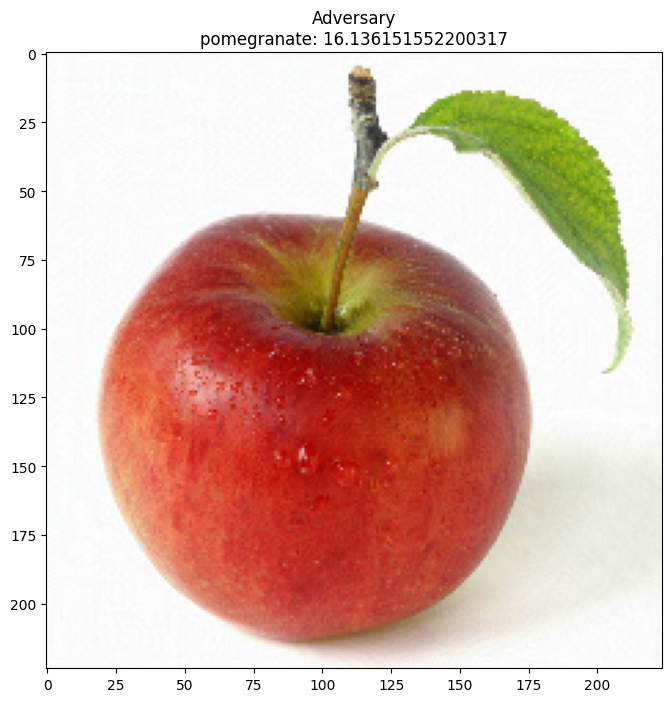

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


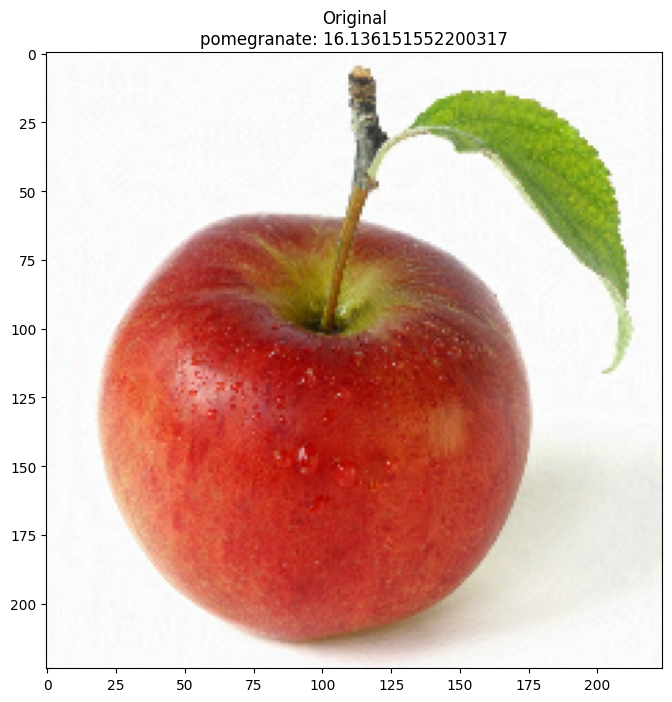

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


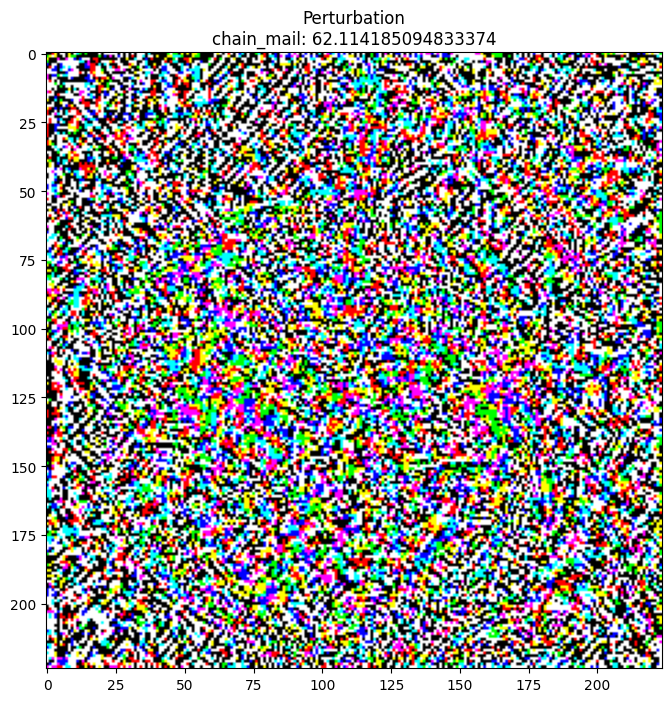

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


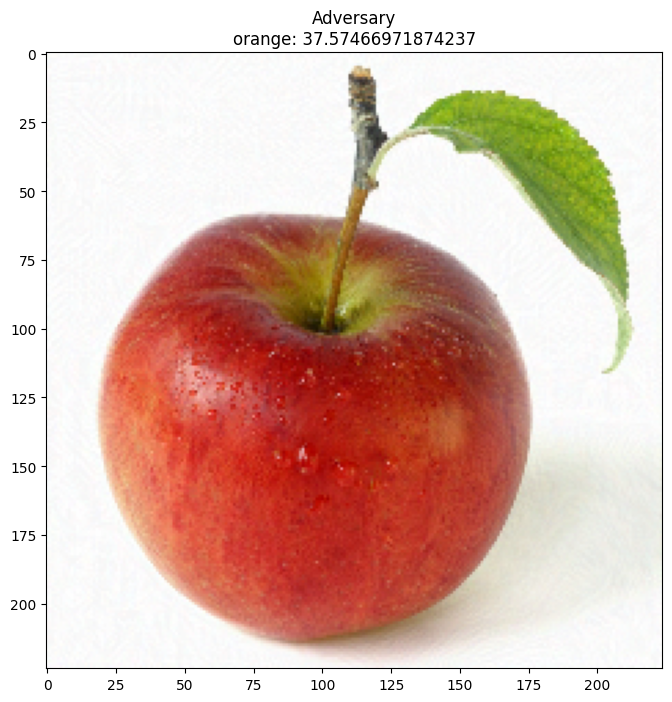

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


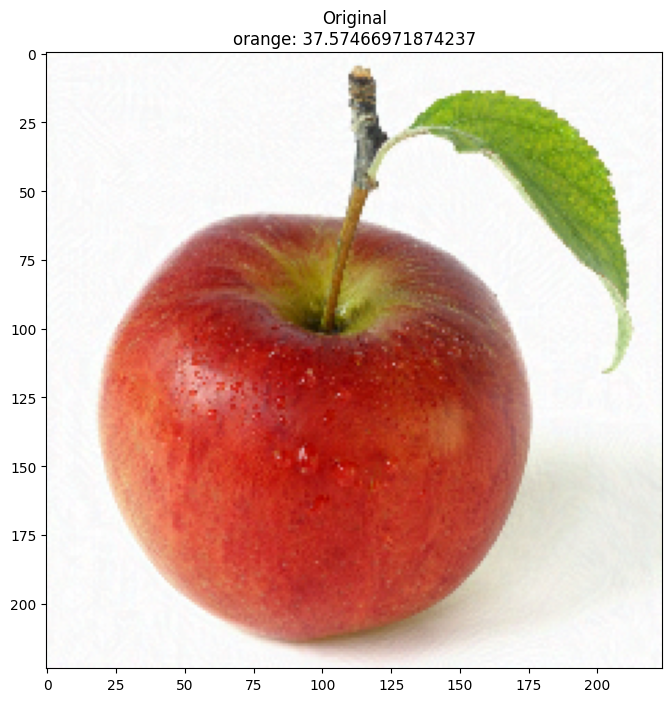

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


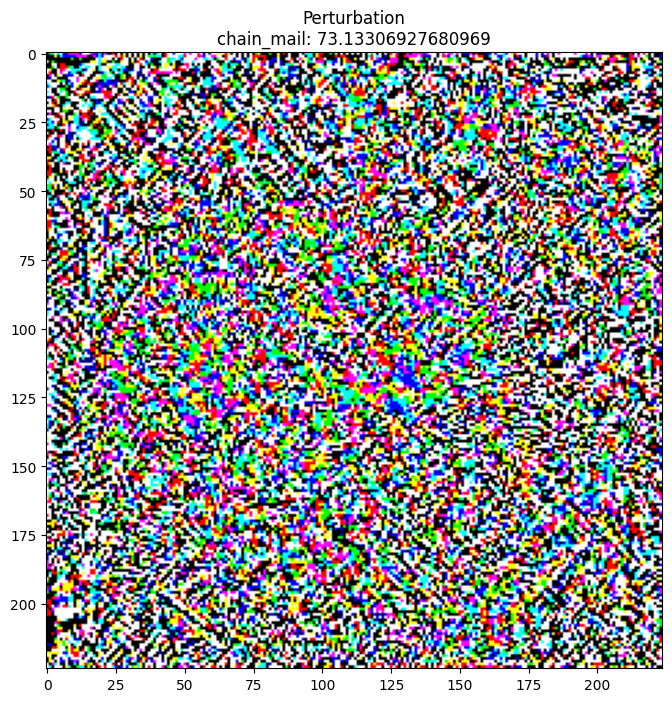

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step


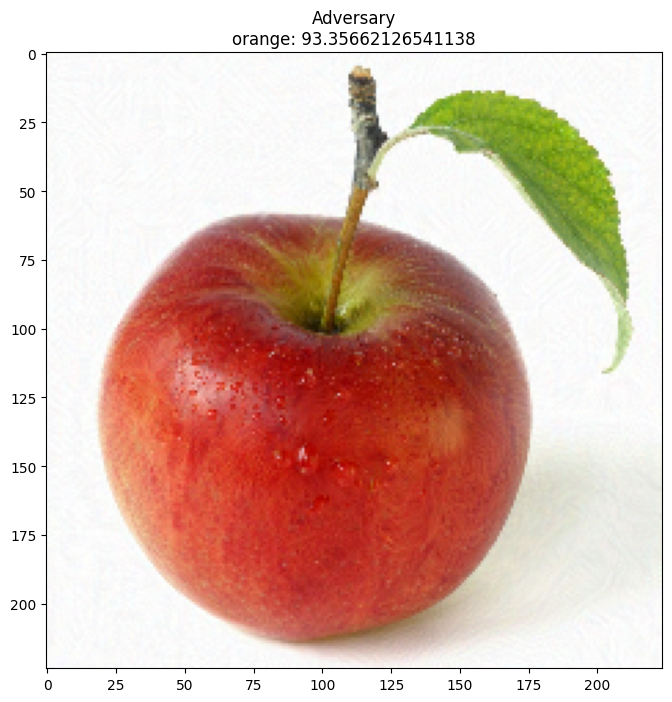

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


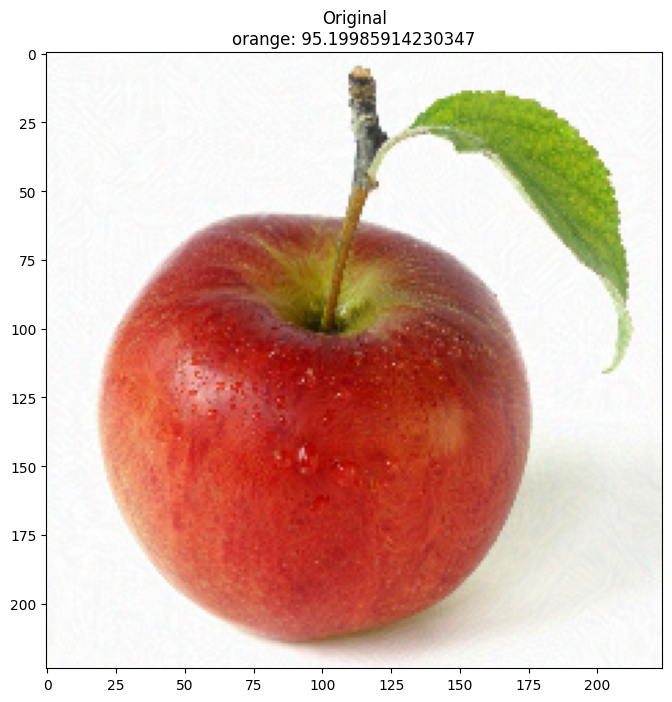

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


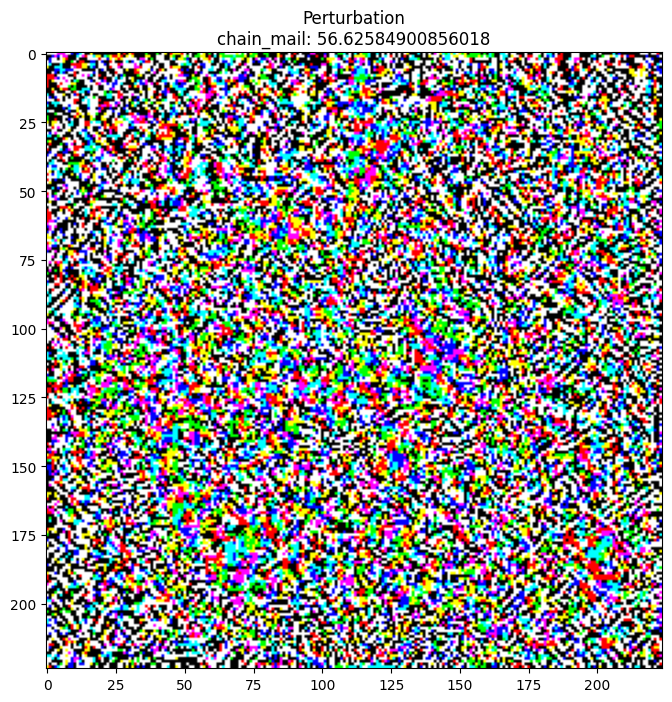

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


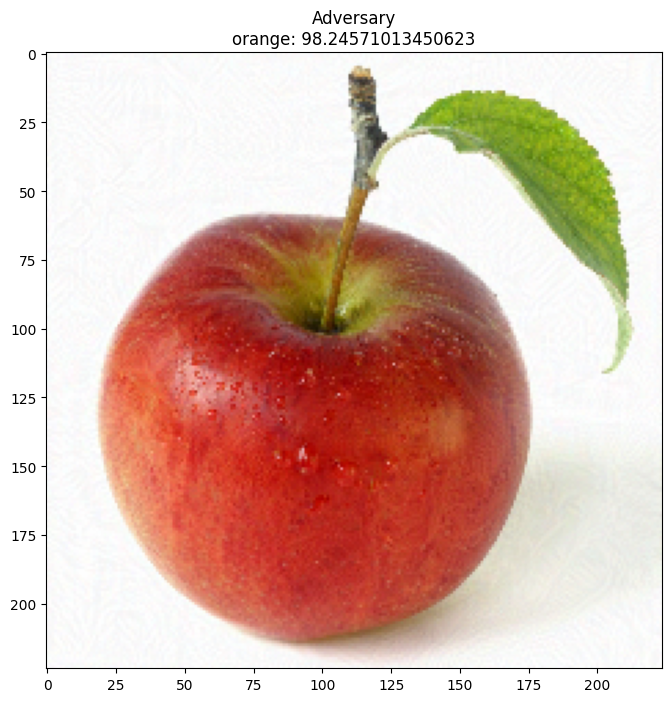

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


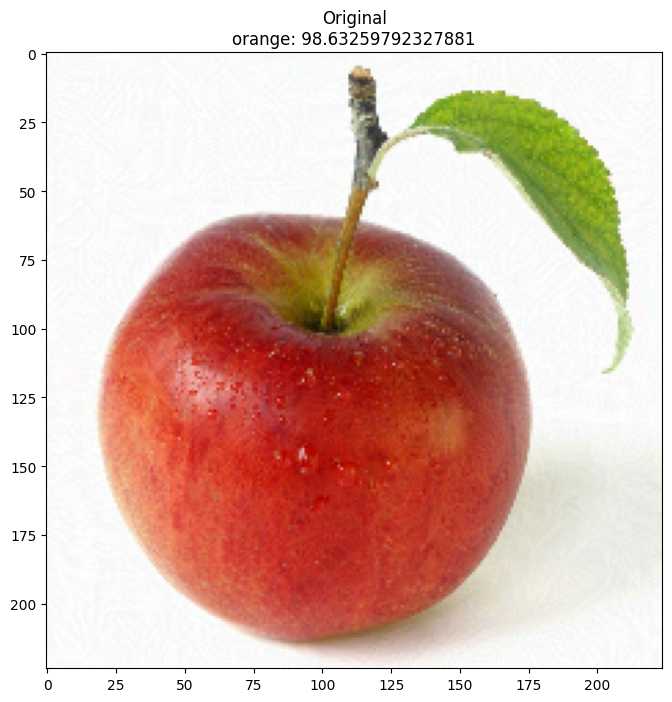

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


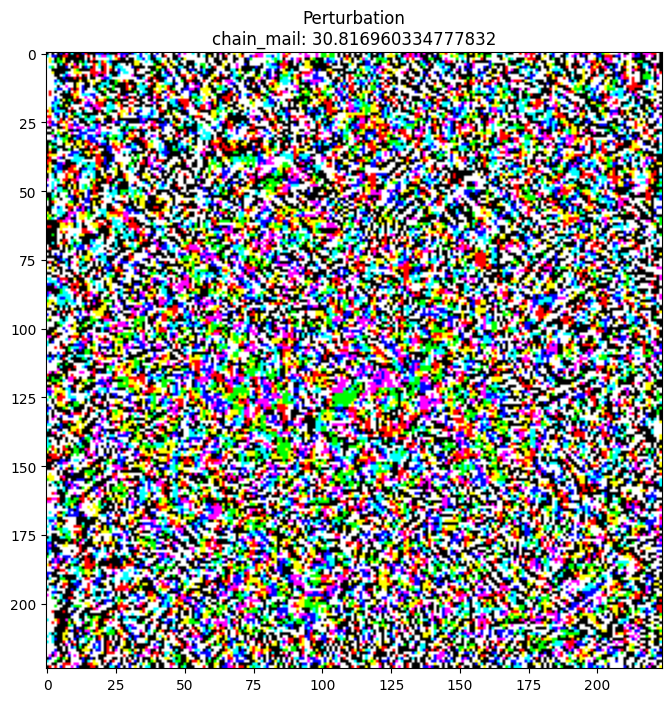

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


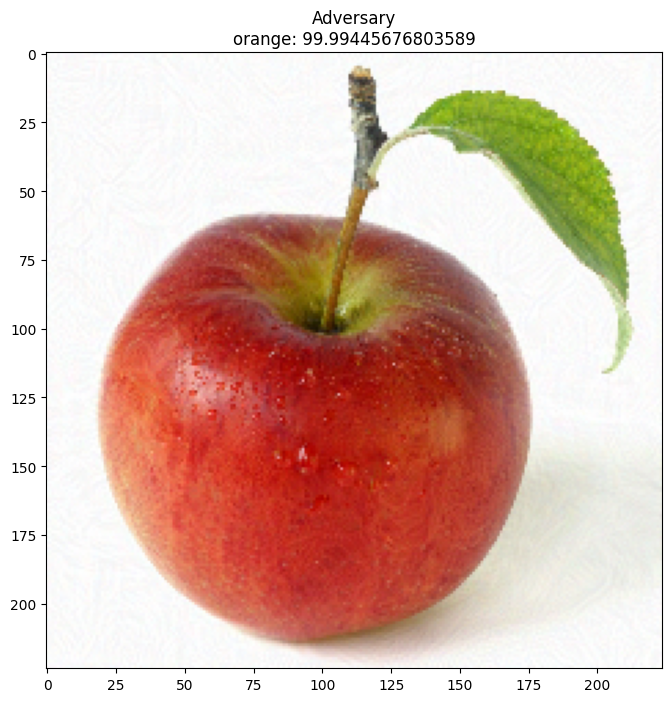

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


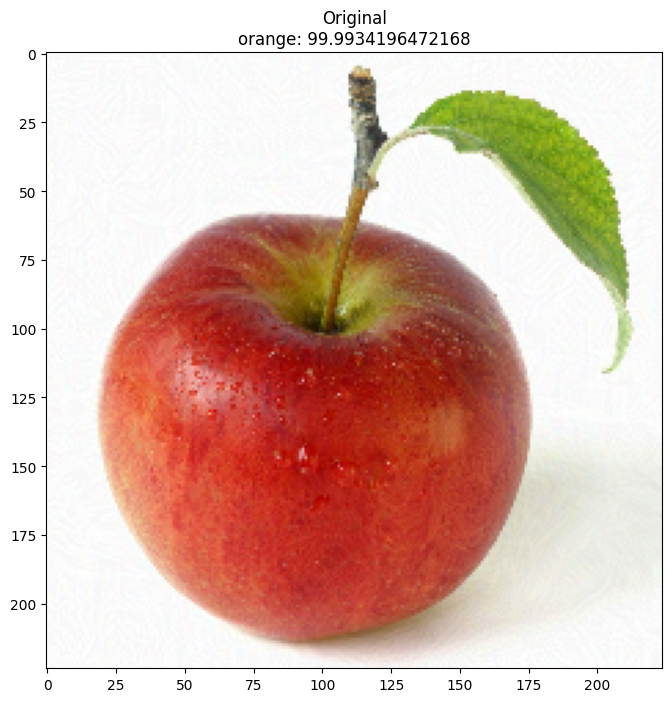

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


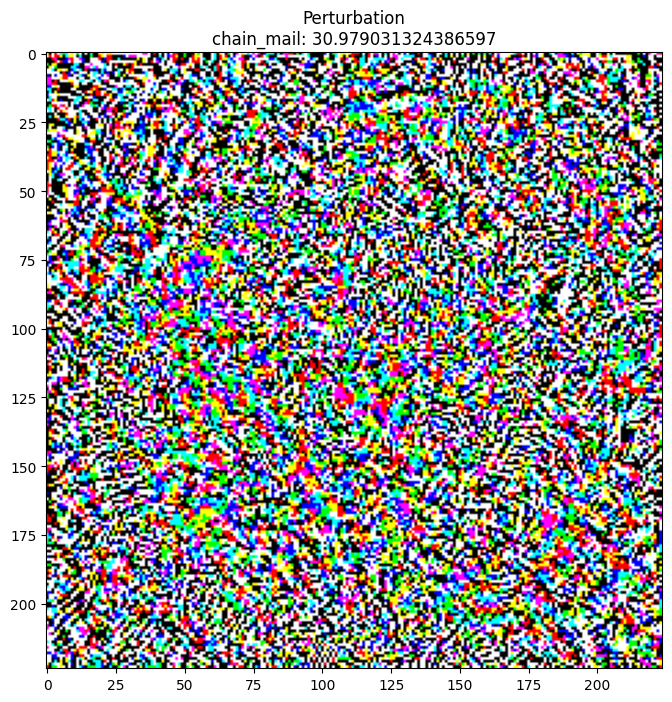

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


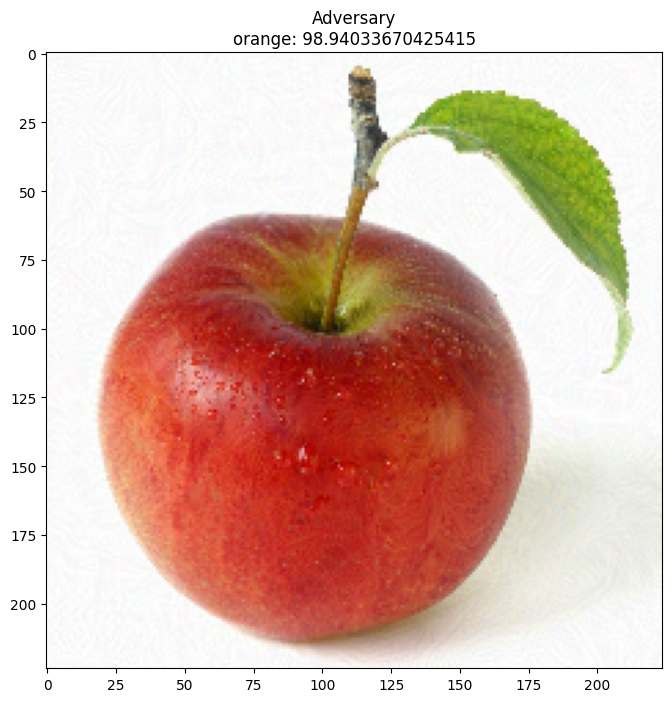

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


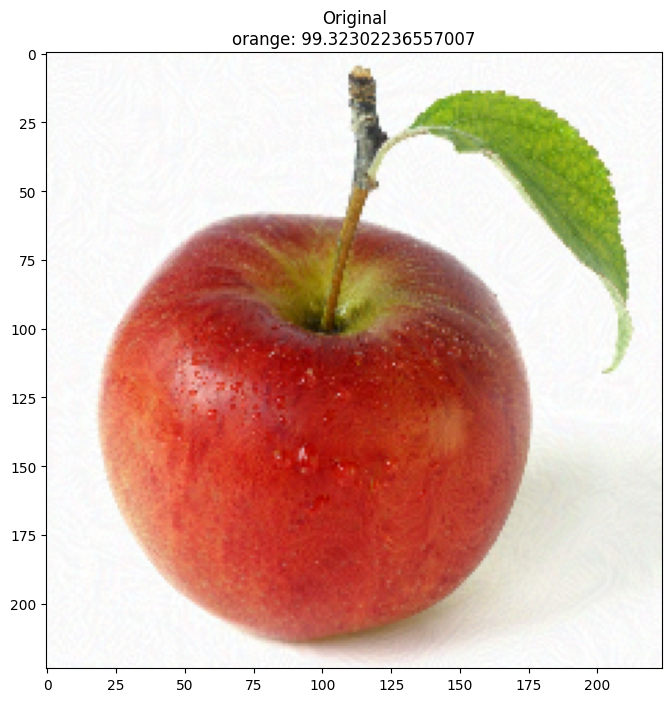

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step


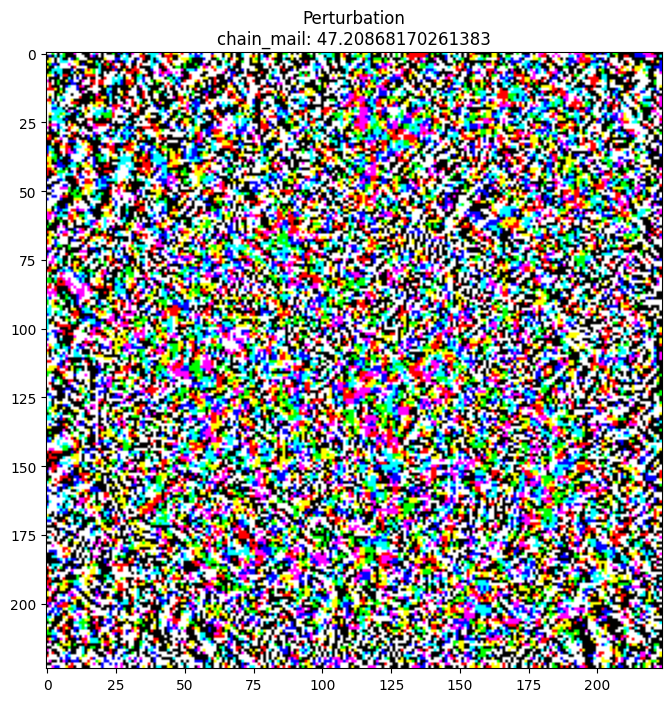

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


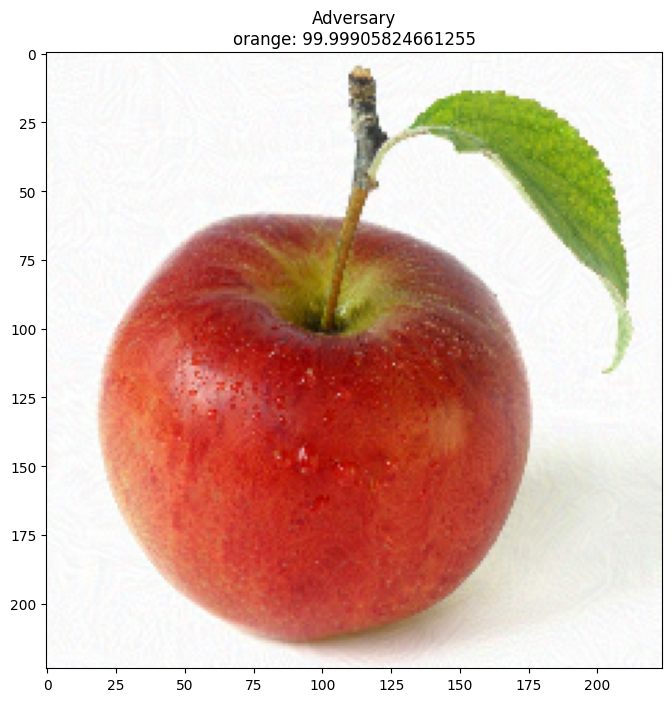

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step


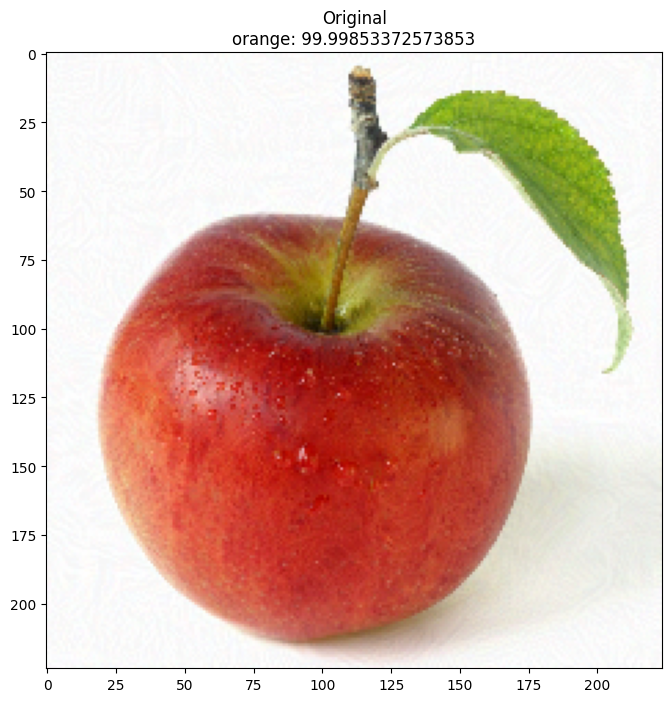

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


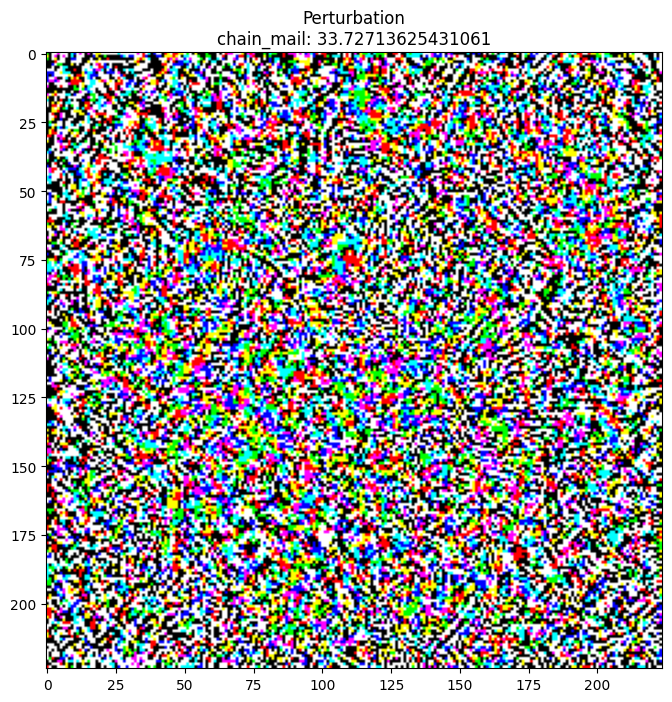

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


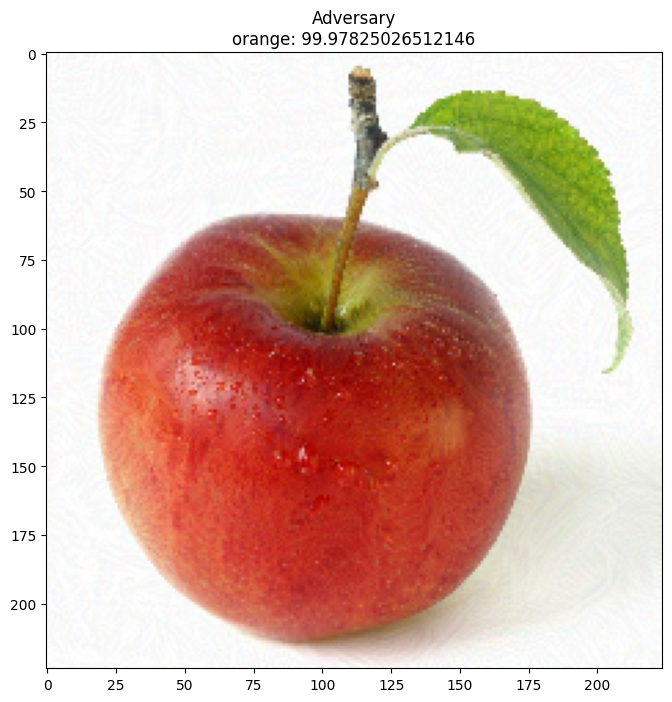

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


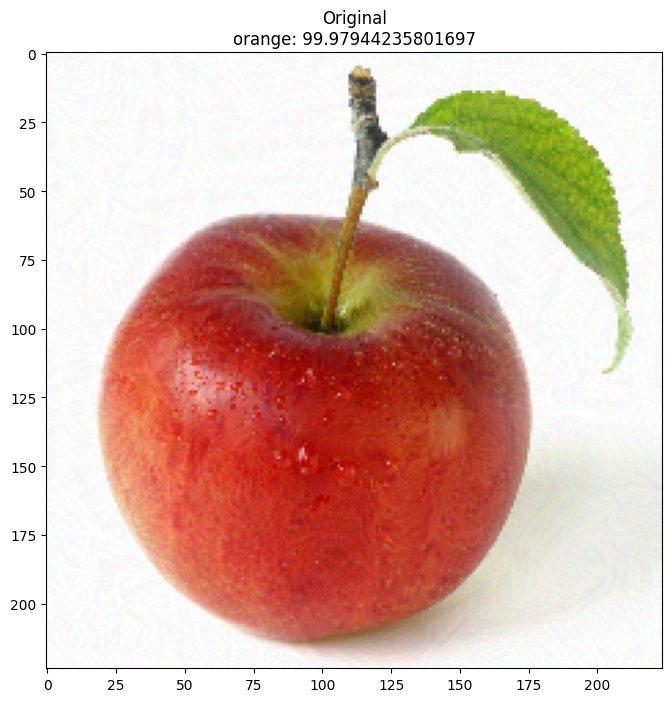

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


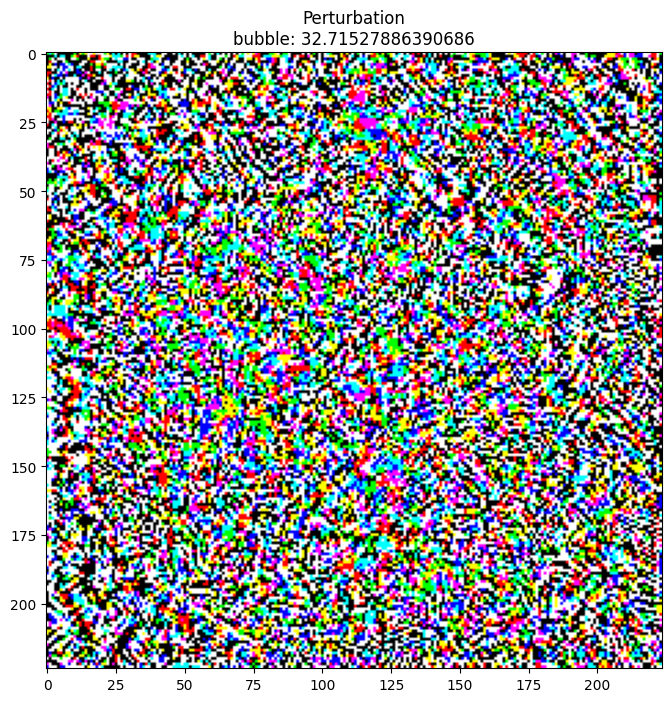

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


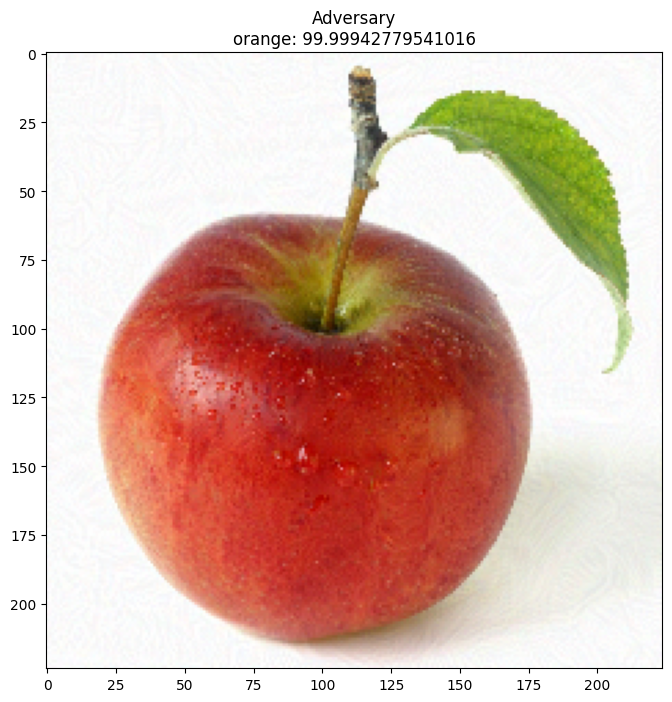

<tf.Tensor: shape=(1, 224, 224, 3), dtype=float32, numpy=
array([[[[0.9486275 , 0.98862743, 0.9372549 ],
         [0.96862745, 1.        , 0.98862743],
         [0.96862745, 1.        , 0.96862745],
         ...,
         [0.98862743, 0.96862745, 0.98862743],
         [0.96862745, 0.9472549 , 0.96862745],
         [0.9486275 , 0.96862745, 0.9372549 ]],

        [[0.9372549 , 0.96862745, 0.9372549 ],
         [0.9486275 , 0.9372549 , 0.9372549 ],
         [0.96862745, 0.9486275 , 0.98862743],
         ...,
         [0.9672549 , 0.9372549 , 0.9486275 ],
         [0.9486275 , 0.96862745, 0.96862745],
         [0.96862745, 0.98862743, 0.99      ]],

        [[0.9372549 , 0.9486275 , 0.9372549 ],
         [0.9372549 , 0.9486275 , 0.9372549 ],
         [1.        , 0.98862743, 0.98862743],
         ...,
         [0.9472549 , 0.9486275 , 0.9486275 ],
         [0.9486275 , 0.9486275 , 0.9486275 ],
         [0.9372549 , 0.9372549 , 0.9372549 ]],

        ...,

        [[0.96862745, 0.98      , 

In [ ]:
PGD_adversary(image, granny_smith_index, 0.01,8/255, 10)